# Visualize outputs of the normalizing flow with animations

In [16]:
#from context import nflows
from orbitflows import GsympNetFlow, generate_orbits
from galpy.actionAngle import actionAngleHarmonic, actionAngleVertical, actionAngleVerticalInverse # ActionAngleVertical only to be used for visual comparison
from orbitflows import actionAngleHarmonicInverse
from galpy.potential import IsothermalDiskPotential
from galpy.orbit import Orbit
#from orbitflows import generate_orbit_ps, guess_aa_pair, plot_aa, H, polar_to_cartesian, cartesian_to_polar, H_sho, generate_sho_orbits, generate_orbits_aa
import numpy as np
from tqdm import tqdm
import torch
import matplotlib.pyplot as plt
plt.rcParams['xtick.direction'] = 'in'
plt.rcParams['ytick.direction'] = 'in'
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['xtick.top'] = True
plt.rcParams['ytick.right'] = True
plt.rcParams['xtick.labeltop'] = False
plt.rcParams['ytick.labelright'] = False
from timeit import time


import torch
import json
from galpy.potential import IsothermalDiskPotential
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd



# relative_path = "../trained_models/"
# filename = 'iso_model_1.4'
# model = ModelLoader(filename, relative_path=relative_path)

# Animate Flow

animate what the successive addition of each layer does to the space

## Phase space

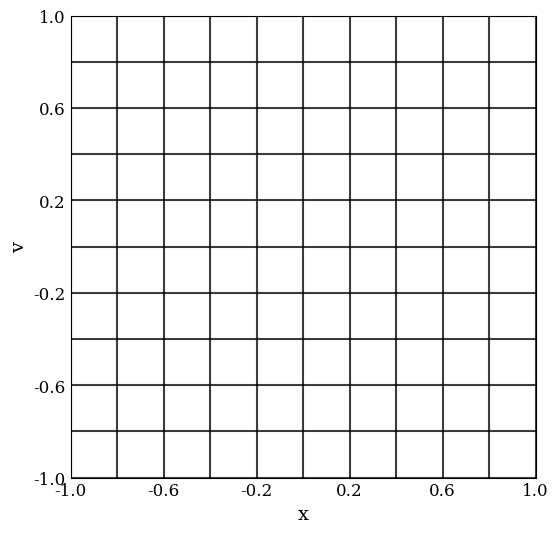

In [3]:
# make a grid in phase space

n = 11
vel = np.linspace(-1, 1, n)
pos = np.linspace(-1, 1, n)
pos, vel = np.meshgrid(pos, vel)

fig, ax = plt.subplots(figsize=(6,6))
ax.plot(pos, vel, c='k', alpha = 0.75) # vertical lines
ax.plot(pos.T, vel.T, c='k', alpha = 0.75) # horizontal lines
ax.set_xlabel('x')
ax.set_ylabel('v')
ax.set_xlim(-1, 1)
ax.set_ylim(-1, 1)

ax.set_xticks(np.linspace(-1, 1, n))
ax.set_yticks(np.linspace(-1, 1, n))
ax.tick_params(axis='both', which='both', length=0)
ax.set_xticklabels([f"{tick:.1f}" if i % 2 == 0 else "" for i, tick in enumerate(np.linspace(-1, 1, n))])
ax.set_yticklabels([f"{tick:.1f}" if i % 2 == 0 else "" for i, tick in enumerate(np.linspace(-1, 1, n))])
ax.grid(True, which='both', linestyle='-', linewidth=0.5, alpha=0.7)

In [4]:
600 / (4/0.2)

30.0

In [5]:
600/8 * 0.2

15.0

In [2]:
# make a grid in phase space
plot_res=0.1
lim = 4
in_between=5
res = int(in_between)
n = int(2*lim*in_between/(plot_res))
vel = torch.arange(-lim, lim, 0.1/in_between)
pos = torch.arange(-lim, lim, 0.1/in_between)
pos, vel = torch.meshgrid(pos, vel)
ps = torch.stack([pos, vel], axis=-1).reshape(-1, 2)

NameError: name 'torch' is not defined

In [7]:
vel.shape

torch.Size([400, 400])

In [8]:
np.arange(-lim, lim, 10)

array([-4])

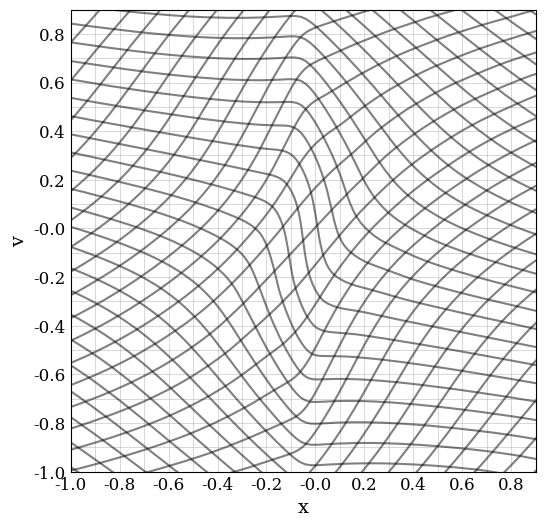

In [216]:
# final 

ps_nf = model.flow(ps)
nf_plot = ps_nf.reshape(n, n, 2)

fig, ax = plt.subplots(figsize=(6,6))
ax.plot(nf_plot[...,0].cpu().detach()[:,::res], nf_plot[...,1].cpu().detach()[:,::res], c='k', alpha=0.5)
ax.plot(nf_plot[...,0].cpu().detach().T[:,::res], nf_plot[...,1].cpu().detach().T[:,::res], c='k', alpha=0.5)

ax.set_xlabel('x')
ax.set_ylabel('v')
ax.set_xlim(-1, 1)
ax.set_ylim(-1, 1)

ax.set_xticks(np.linspace(-1, 1, int(n/(res*lim))))
ax.set_yticks(np.linspace(-1, 1, int(n/(res*lim))))
ax.tick_params(axis='both', which='both', length=0)
ax.set_xticklabels([f"{tick:.1f}" if i % 2 == 0 else "" for i, tick in enumerate(np.arange(-1, 1, plot_res))])
ax.set_yticklabels([f"{tick:.1f}" if i % 2 == 0 else "" for i, tick in enumerate(np.arange(-1, 1,plot_res))])
ax.grid(True, which='both', linestyle='-', linewidth=0.5, alpha=0.7)

In [223]:
model.flow.layers[:10]

ModuleList(
  (0-9): 10 x SymplecticCouplingLayer(
    (conditioner): GradientBasedConditioner()
  )
)

In [3]:
# final 
ps_nf_ = ps.clone()
for layer in model.flow.layers[:52]:
    ps_nf_ = layer(ps_nf_)
nf_plot = ps_nf_.reshape(n, n, 2)

# Create figure with dark background
fig, ax = plt.subplots(figsize=(8,6), facecolor='none')
ax.set_facecolor('none')

# Plot grid lines in white
ax.plot(nf_plot[...,0].cpu().detach()[:,::res], nf_plot[...,1].cpu().detach()[:,::res], c='white', alpha=1, lw=0.2)
ax.plot(nf_plot[...,0].cpu().detach().T[:,::res], nf_plot[...,1].cpu().detach().T[:,::res], c='white', alpha=1, lw=0.2)

ax.set_xlim(-1, 1)
ax.set_ylim(-1, 1)

ax.set_xticks([])
ax.set_yticks([])
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
fig.savefig('grid_transform_ppt_background.png', dpi=600, bbox_inches='tight', facecolor='none')

NameError: name 'ps' is not defined

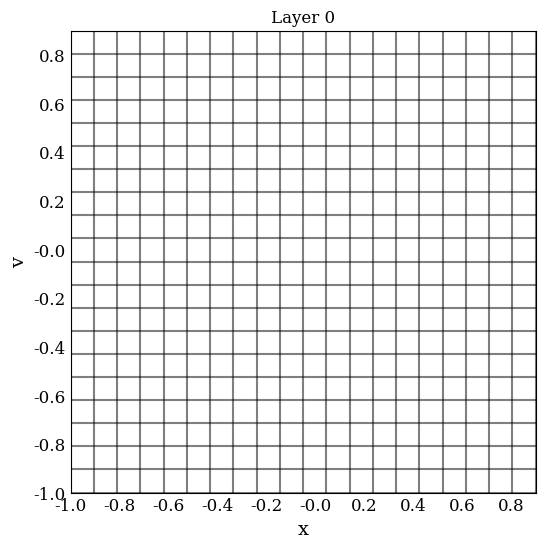

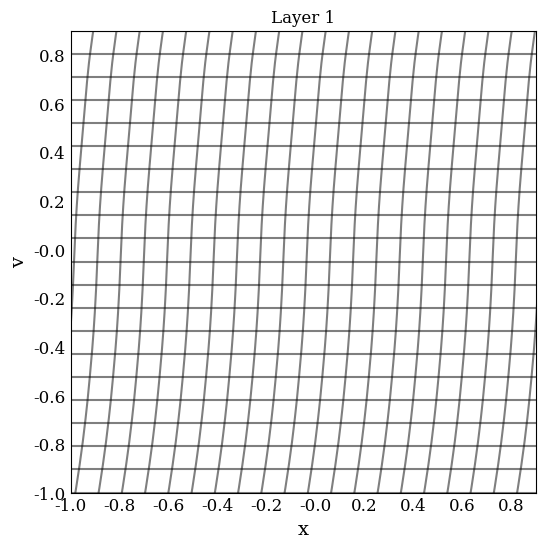

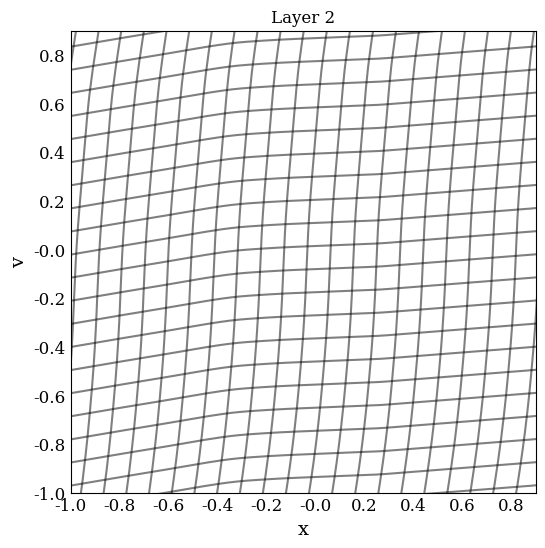

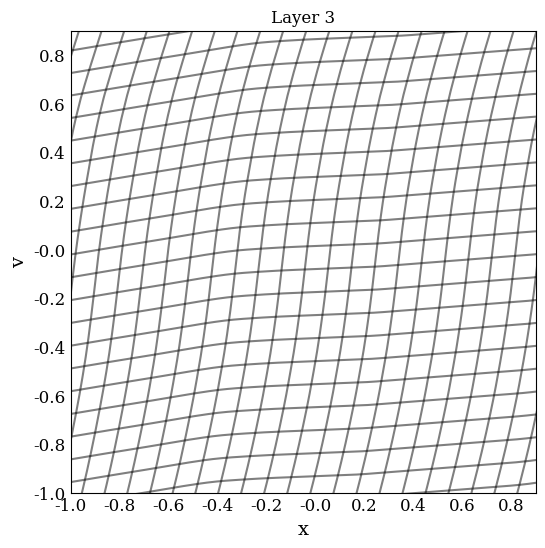

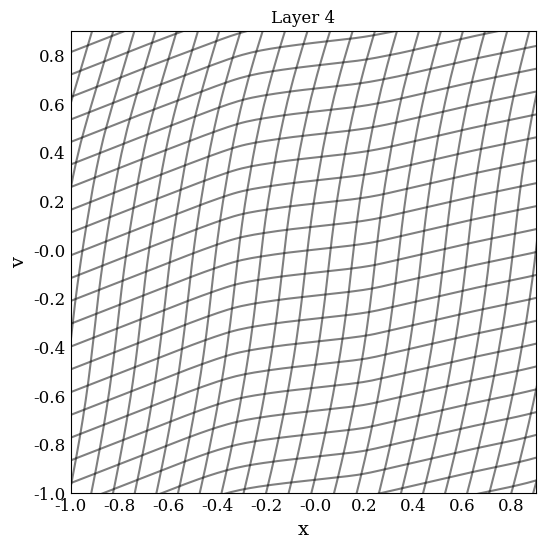

...

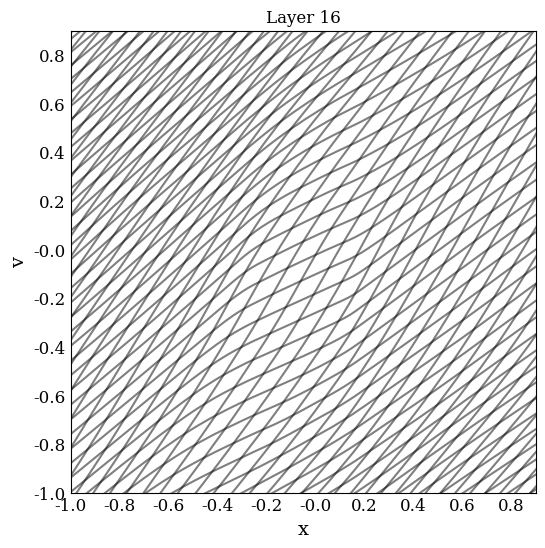

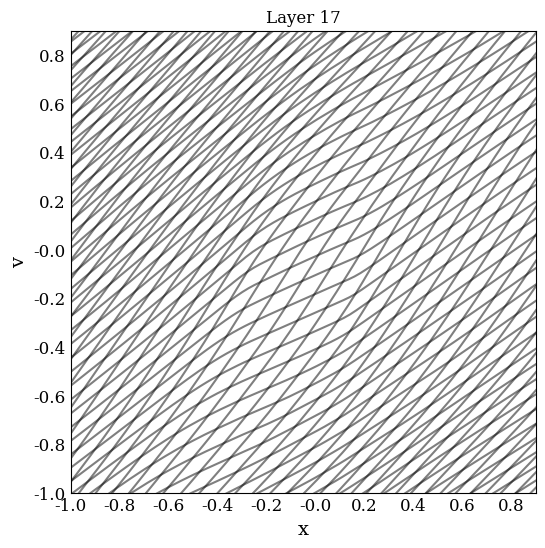

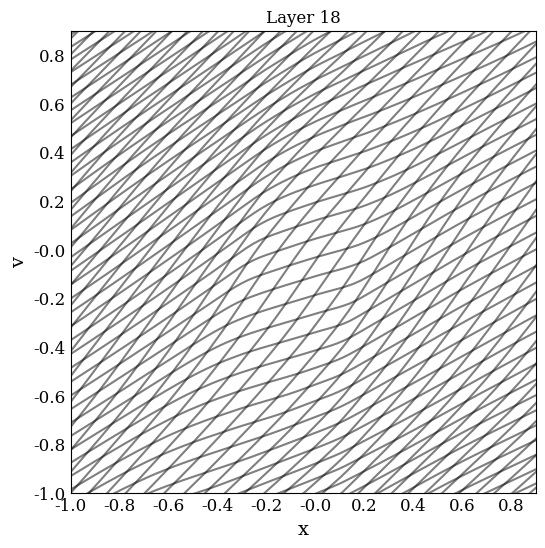

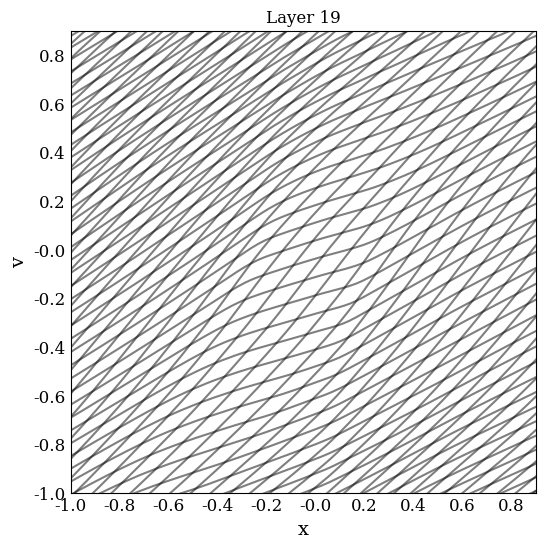

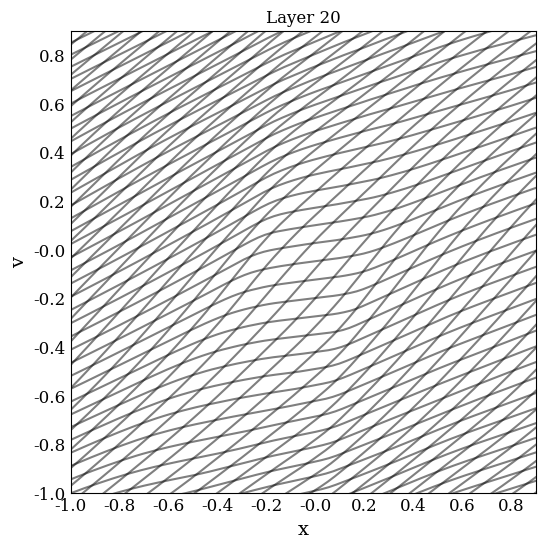

KeyboardInterrupt: 

In [13]:
# Transform the grid with each layer and plot
for layer_i in np.arange(0, len(model.flow.layers)):
    ps_nf = ps.clone()
    if layer_i != 0:
        for layer in model.flow.layers[:layer_i]:
            ps_nf = layer(ps_nf)
    nf_plot = ps_nf.reshape(n, n, 2)

    fig, ax = plt.subplots(figsize=(6,6))
    ax.plot(nf_plot[...,0].cpu().detach()[:,::res], nf_plot[...,1].cpu().detach()[:,::res], c='k', alpha=0.5)
    ax.plot(nf_plot[...,0].cpu().detach().T[:,::res], nf_plot[...,1].cpu().detach().T[:,::res], c='k', alpha=0.5)

    ax.set_xlabel('x')
    ax.set_ylabel('v')
    ax.set_xlim(-1, 1)
    ax.set_ylim(-1, 1)

    ax.set_xticks(np.linspace(-1, 1, int(n/(res*lim))))
    ax.set_yticks(np.linspace(-1, 1, int(n/(res*lim))))
    ax.tick_params(axis='both', which='both', length=0)
    ax.set_xticklabels([f"{tick:.1f}" if i % 2 == 0 else "" for i, tick in enumerate(np.arange(-1, 1, plot_res))])
    ax.set_yticklabels([f"{tick:.1f}" if i % 2 == 0 else "" for i, tick in enumerate(np.arange(-1, 1, plot_res))])
    #ax.grid(True, which='both', linestyle='-', linewidth=0.5, alpha=0.7)
    ax.set_title(f'Layer {layer_i}')
    plt.show()

Animation size has reached 21159663 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


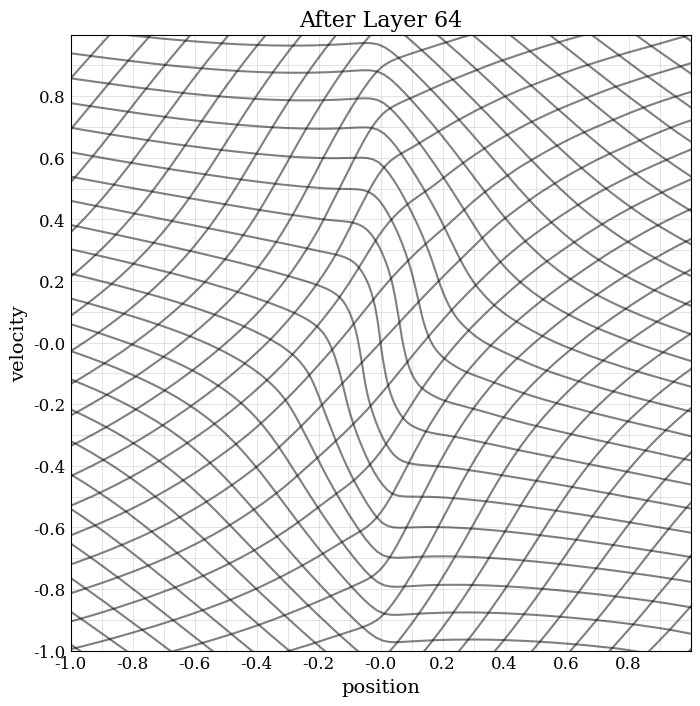

In [67]:
from IPython.display import HTML

import matplotlib.animation as animation

# Create a figure for the animation
fig, ax = plt.subplots(figsize=(8, 8))

# Initialize empty plots for horizontal and vertical lines
horizontal_lines, = ax.plot([], [], 'k', alpha=0.5)
vertical_lines, = ax.plot([], [], 'k', alpha=0.5)

# Set up the axis properties
ax.set_xlim(-1, 1)
ax.set_ylim(-1, 1)
ax.set_xlabel('position', fontsize=14)
ax.set_ylabel('velocity', fontsize=14)
ax.set_xticks(np.arange(-1, 1, plot_res))
ax.set_yticks(np.arange(-1, 1, plot_res))
ax.tick_params(axis='both', which='both', length=0)
ax.set_xticklabels([f"{tick:.1f}" if i % 2 == 0 else "" for i, tick in enumerate(np.arange(-1, 1, plot_res))])
ax.set_yticklabels([f"{tick:.1f}" if i % 2 == 0 else "" for i, tick in enumerate(np.arange(-1, 1, plot_res))])
ax.grid(True, which='both', linestyle='-', linewidth=0.5, alpha=0.5)

# Title with layer counter
title = ax.set_title('Original Grid', fontsize=16)


def init():
    horizontal_lines.set_data([], [])
    vertical_lines.set_data([], [])
    return horizontal_lines, vertical_lines, title

def animate(i):
    if i == 0:
        # Original grid
        grid = ps.reshape(n, n, 2)
        title.set_text('Original Grid')
    else:
        # Apply the first i layers
        ps_transformed = ps.clone()
        for layer_idx in range(i):
            ps_transformed = model.flow.layers[layer_idx](ps_transformed)
        grid = ps_transformed.reshape(n, n, 2)

    # Extract x and y coordinates for the horizontal and vertical grid lines
    h_x = grid[..., 0].cpu().detach().numpy()
    h_y = grid[..., 1].cpu().detach().numpy()
    v_x = h_x.T
    v_y = h_y.T
    
    # Update the data for the grid lines
    # Plot each horizontal line separately to prevent wrapping
    horizontal_lines.set_data([], [])  # Clear existing data
    vertical_lines.set_data([], [])    # Clear existing data
    
    # Clear previous lines
    for line in ax.get_lines():
        if line != horizontal_lines and line != vertical_lines:
            line.remove()
    
    # Draw each horizontal line (row)
    for j in np.arange(0, n, res):
        ax.plot(h_x[j], h_y[j], 'k', alpha=0.5)
    
    # Draw each vertical line (column)
    for j in np.arange(0, n, res):
        ax.plot(v_x[j], v_y[j], 'k', alpha=0.5)
    
    if i > 0:
        title.set_text(f'After Layer {i}')
    
    return horizontal_lines, vertical_lines, title

# Create the animation
total_layers = len(model.flow.layers)
ani = animation.FuncAnimation(fig, animate, frames=total_layers+1,
                              init_func=init, blit=True, interval=500)

# Display the animation in the notebook
HTML(ani.to_jshtml())

In [18]:
64/10

6.4

In [68]:

Writer = animation.writers['ffmpeg']
writer = Writer(fps=7, metadata=dict(artist='Me'), bitrate=1800)
    
# Save the animation to an MP4 file
output_file = "grid_transformation.mp4"
ani.save(output_file, writer=writer)
print(f"Animation saved to {output_file}")


Animation saved to grid_transformation.mp4


In [20]:
from orbitflows import generate_sho_orbits

In [21]:
omega_guess = 1.0
aAHI_guess = actionAngleHarmonicInverse(omega = omega_guess)
n_actions = 5
n_angles = 1000
r_min = 0.2
r_max = 0.7
ps_guess, aa_guess = generate_sho_orbits(n_actions, omega=omega_guess, t_end=10, n_steps=n_angles, r_bounds=[r_min,r_max])

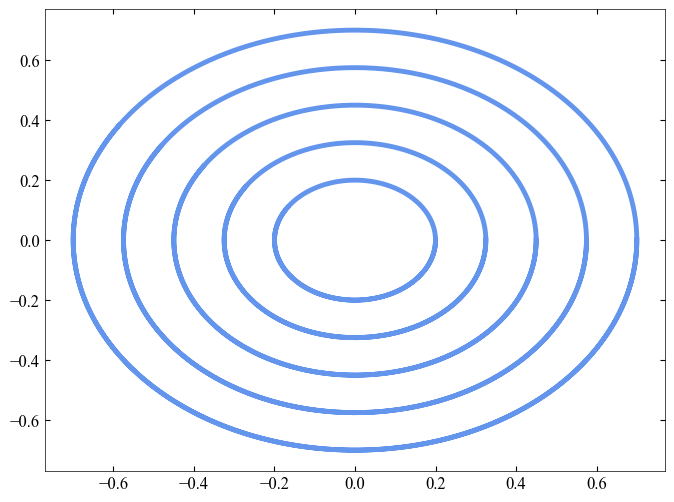

In [22]:
for orb in ps_guess.reshape(n_actions, n_angles, 2):
    plt.plot(orb[:,0], orb[:,1], c='cornflowerblue', linewidth=3.5)
plt.show()

In [23]:
ps_guess.shape

torch.Size([5, 1000, 2])

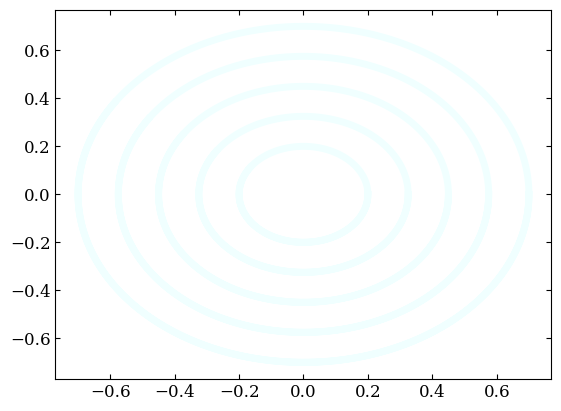

In [27]:
for orb in ps_guess.reshape(n_actions, n_angles, 2):
    plt.plot(orb[:,0], orb[:,1], c='azure', linewidth=5)
plt.show()

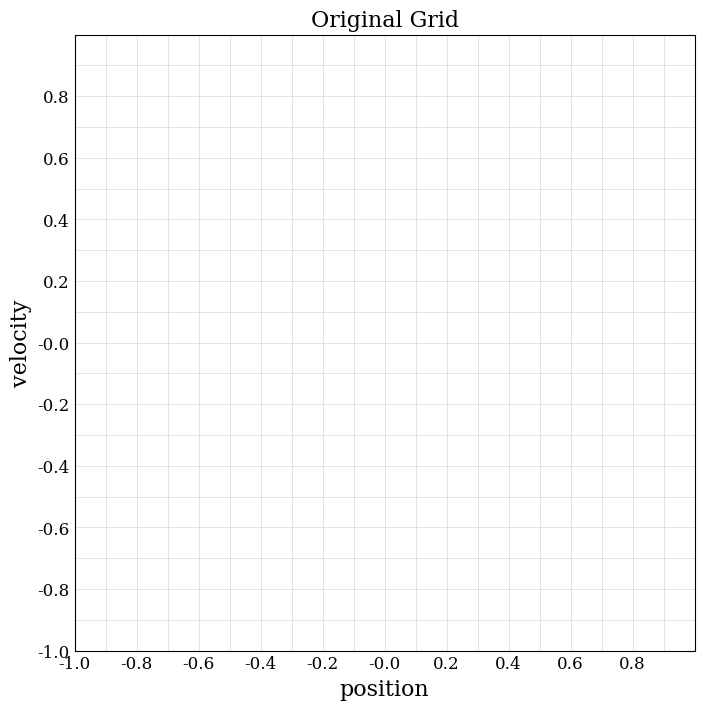

In [65]:
# now add an orbit over it:
from IPython.display import HTML

import matplotlib.animation as animation

# Create a figure for the animation
fig, ax = plt.subplots(figsize=(8, 8))

# Initialize empty plots for horizontal and vertical lines
horizontal_lines, = ax.plot([], [], 'k', alpha=0.5)
vertical_lines, = ax.plot([], [], 'k', alpha=0.5)

# Set up the axis properties
ax.set_xlim(-1, 1)
ax.set_ylim(-1, 1)
ax.set_xlabel('position', fontsize=16)
ax.set_ylabel('velocity', fontsize=16)
ax.set_xticks(np.arange(-1, 1, plot_res))
ax.set_yticks(np.arange(-1, 1, plot_res))
ax.tick_params(axis='both', which='both', length=0)
ax.set_xticklabels([f"{tick:.1f}" if i % 2 == 0 else "" for i, tick in enumerate(np.arange(-1, 1, plot_res))])
ax.set_yticklabels([f"{tick:.1f}" if i % 2 == 0 else "" for i, tick in enumerate(np.arange(-1, 1, plot_res))])
ax.grid(True, which='both', linestyle='-', linewidth=0.5, alpha=0.5)

# Title with layer counter
title = ax.set_title('Original Grid', fontsize=16)


def init():

    horizontal_lines.set_data([], [])
    vertical_lines.set_data([], [])
    return horizontal_lines, vertical_lines, title

def animate(i):
    if i == 0:
        # Original grid
        orbit_transformed = ps_guess.clone()
        grid = ps.reshape(n, n, 2)
        title.set_text('Original Grid')
    else:
        # Apply the first i layers
        ps_transformed = ps.clone()
        orbit_transformed = ps_guess.clone()
        for layer_idx in range(i):
            ps_transformed = model.flow.layers[layer_idx](ps_transformed)
            orbit_transformed = model.flow.layers[layer_idx](orbit_transformed)
        grid = ps_transformed.reshape(n, n, 2)

    # Extract x and y coordinates for the horizontal and vertical grid lines
    h_x = grid[..., 0].cpu().detach().numpy()
    h_y = grid[..., 1].cpu().detach().numpy()
    v_x = h_x.T
    v_y = h_y.T
    
    # Update the data for the grid lines
    # Plot each horizontal line separately to prevent wrapping
    horizontal_lines.set_data([], [])  # Clear existing data
    vertical_lines.set_data([], [])    # Clear existing data
    
    # Clear previous lines
    for line in ax.get_lines():
        if line != horizontal_lines and line != vertical_lines:
            line.remove()
    
    # Draw each horizontal line (row)
    for j in np.arange(0, n, res):
        ax.plot(h_x[j], h_y[j], 'k', alpha=0.4)
    
    # Draw each vertical line (column)
    for j in np.arange(0, n, res):
        ax.plot(v_x[j], v_y[j], 'k', alpha=0.4)
    
    if i > 0:
        title.set_text(f'After Layer {i}')
    for orb in orbit_transformed.reshape(n_actions, n_angles, 2):
        ax.plot(orb[:,0].cpu().detach(), orb[:,1].cpu().detach(), c='cornflowerblue', linewidth=3.5)
    return horizontal_lines, vertical_lines, title

# Create the animation
total_layers = len(model.flow.layers)
ani_with_orbit = animation.FuncAnimation(fig, animate, frames=total_layers+1,
                              init_func=init, blit=True, interval=500)

# # Display the animation in the notebook
# HTML(ani.to_jshtml())

In [17]:
ps_guess

NameError: name 'ps_guess' is not defined

<>:78: SyntaxWarning: invalid escape sequence '\c'

<>:78: SyntaxWarning: invalid escape sequence '\c'

/tmp/ipykernel_1737678/3568671599.py:78: SyntaxWarning: invalid escape sequence '\c'
  title.set_text(f'$\\mathbf{{\\psi_{{{i}}}}}\circ \cdot \cdot \cdot \circ \\psi_1(q, p)$')



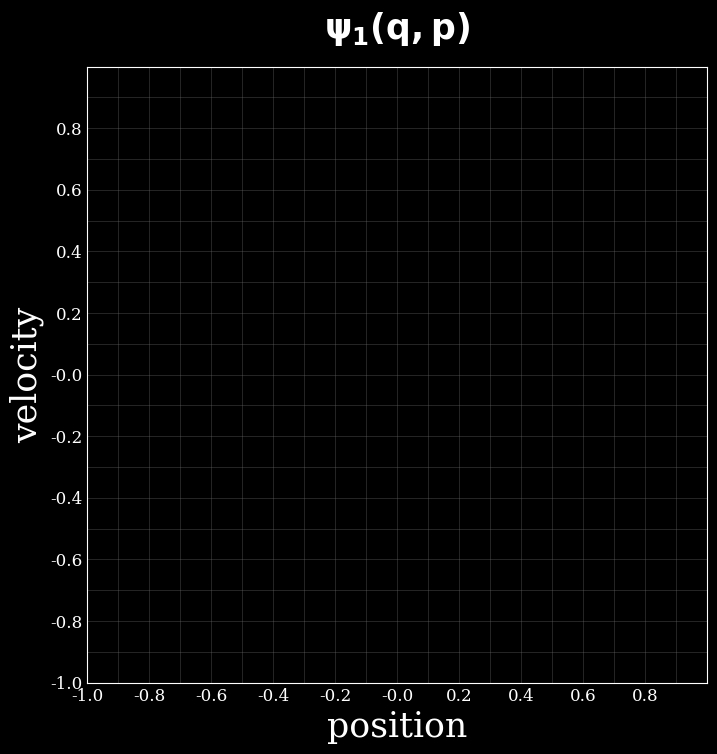

In [214]:
# now add an orbit over it:
from IPython.display import HTML

import matplotlib.animation as animation

# Create a figure for the animation with dark background
fig, ax = plt.subplots(figsize=(8, 8), facecolor='black')
ax.set_facecolor('black')

# Initialize empty plots for horizontal and vertical lines
horizontal_lines, = ax.plot([], [], 'w', alpha=0.4)
vertical_lines, = ax.plot([], [], 'w', alpha=0.4)

# Set up the axis properties
ax.set_xlim(-1, 1)
ax.set_ylim(-1, 1)
ax.set_xlabel('position', fontsize=25, color='white')
ax.set_ylabel('velocity', fontsize=25, color='white')
ax.set_xticks(np.arange(-1, 1, plot_res))
ax.set_yticks(np.arange(-1, 1, plot_res))
ax.tick_params(axis='both', which='both', length=0, colors='white')
ax.set_xticklabels([f"{tick:.1f}" if i % 2 == 0 else "" for i, tick in enumerate(np.arange(-1, 1, plot_res))])
ax.set_yticklabels([f"{tick:.1f}" if i % 2 == 0 else "" for i, tick in enumerate(np.arange(-1, 1, plot_res))])
ax.grid(True, which='both', linestyle='-', linewidth=0.5, alpha=0.5, color='dimgray')

# Title with layer counter
title = ax.set_title('$\\mathbf{\\psi_1(q, p)}$', fontsize=25, color='white', pad=20, weight='bold')

# Set spines color to white
for spine in ax.spines.values():
    spine.set_color('white')

def init():
    horizontal_lines.set_data([], [])
    vertical_lines.set_data([], [])
    return horizontal_lines, vertical_lines, title

def animate(i):
    if i == 0:
        # Original grid
        orbit_transformed = ps_guess.clone()
        grid = ps.reshape(n, n, 2)
        title.set_text('$\\mathbf{\\psi_1(q, p)}$')
    else:
        # Apply the first i layers
        ps_transformed = ps.clone()
        orbit_transformed = ps_guess.clone()
        for layer_idx in range(i):
            ps_transformed = model.flow.layers[layer_idx](ps_transformed)
            orbit_transformed = model.flow.layers[layer_idx](orbit_transformed)
        grid = ps_transformed.reshape(n, n, 2)

    # Extract x and y coordinates for the horizontal and vertical grid lines
    h_x = grid[..., 0].cpu().detach().numpy()
    h_y = grid[..., 1].cpu().detach().numpy()
    v_x = h_x.T
    v_y = h_y.T
    
    # Update the data for the grid lines
    # Plot each horizontal line separately to prevent wrapping
    horizontal_lines.set_data([], [])  # Clear existing data
    vertical_lines.set_data([], [])    # Clear existing data
    
    # Clear previous lines
    for line in ax.get_lines():
        if line != horizontal_lines and line != vertical_lines:
            line.remove()
    
    # Draw each horizontal line (row)
    for j in np.arange(0, n, res):
        ax.plot(h_x[j], h_y[j], 'w', alpha=0.4)
    
    # Draw each vertical line (column)
    for j in np.arange(0, n, res):
        ax.plot(v_x[j], v_y[j], 'w', alpha=0.4)
    
    if i > 0:
        title.set_text(f'$\\mathbf{{\\psi_{{{i}}}}}\circ \cdot \cdot \cdot \circ \\psi_1(q, p)$')
    for orb in orbit_transformed.reshape(n_actions, n_angles, 2):
        ax.plot(orb[:,0].cpu().detach(), orb[:,1].cpu().detach(), c='cornflowerblue', linewidth=3.5)
    return horizontal_lines, vertical_lines, title

# Create the animation
total_layers = len(model.flow.layers)
ani_with_orbit = animation.FuncAnimation(fig, animate, frames=total_layers+1,
                              init_func=init, blit=True, interval=500)

# # Display the animation in the notebook
# HTML(ani.to_jshtml())

In [215]:

Writer = animation.writers['ffmpeg']
writer = Writer(fps=7, metadata=dict(artist='Me'), bitrate=1800)
    
# Save the animation to an MP4 file
output_file = "grid_transformation_with_orbit_black.mp4"
ani_with_orbit.save(output_file, writer=writer)
print(f"Animation saved to {output_file}")

Animation saved to grid_transformation_with_orbit_black.mp4


In [32]:
# Display the animation in the notebook
HTML(ani_with_orbit.to_jshtml())

Exception ignored in: <function TransformNode.set_children.<locals>.<lambda> at 0x78981e163e20>
Traceback (most recent call last):
  File "/geir_data/scr/gabrielspace/miniforge3/envs/ML_Dyn/lib/python3.12/site-packages/matplotlib/transforms.py", line 195, in <lambda>
    self, lambda _, pop=child._parents.pop, k=id_self: pop(k))

KeyboardInterrupt: 


KeyboardInterrupt: 

In [75]:
from nflows import generate_orbit_ps

In [74]:
from galpy.potential import IsothermalDiskPotential
pot = IsothermalDiskPotential()
aAHI = actionAngleHarmonicInverse(omega=1)
aAV = actionAngleVertical(pot=pot)

In [133]:
# orbits in isothermal disk
ps_iso = generate_orbit_ps(5, pot, 10, 1000, r_bounds=[0.2, 0.8])

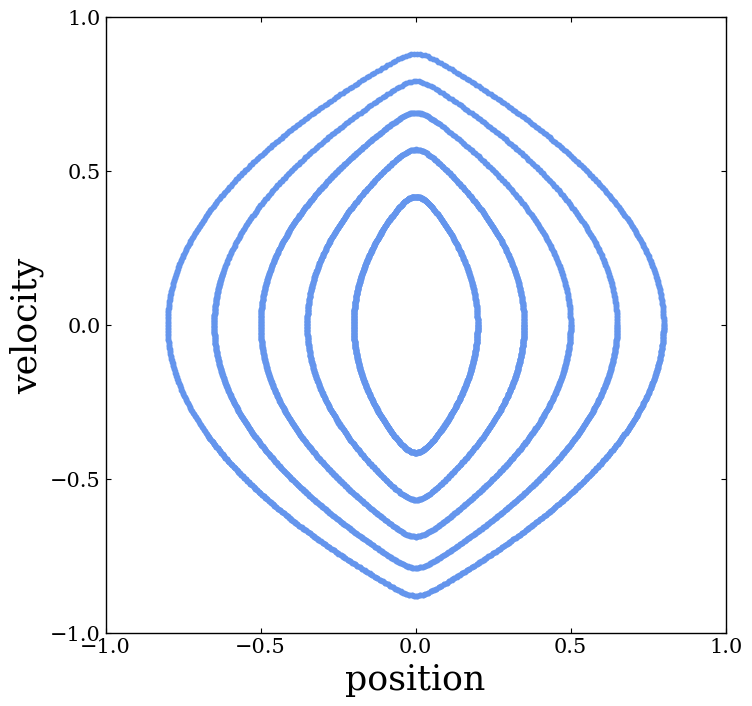

In [134]:
fig, ax = plt.subplots(figsize=(8,8))
ax.scatter(ps_iso[:,0], ps_iso[:,1], c='cornflowerblue', s=10)
ax.set_xlabel('position', fontsize=25)
ax.set_ylabel('velocity', fontsize=25)
ax.set_xlim(-0.9, 0.9)
ax.set_ylim(-0.9, 0.9)
ax.set_xticks(np.arange(-1, 1.5, 0.5))
ax.set_yticks(np.arange(-1, 1.5, 0.5))
ax.tick_params(axis='both', labelsize=15)
for spine in ax.spines.values():
    spine.set_linewidth(1)
fig.savefig('iso_orbits_white.png', dpi=300, bbox_inches='tight')

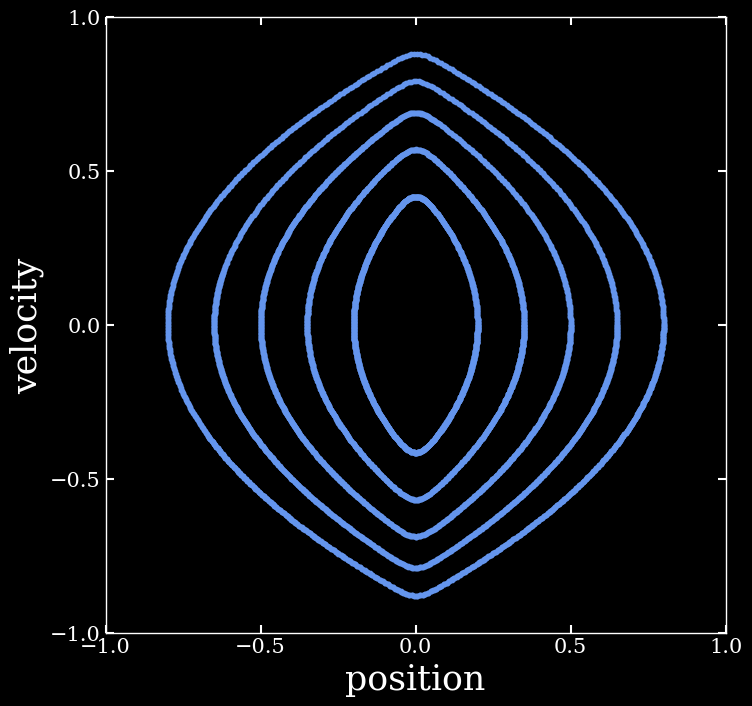

In [135]:
# Create a figure with dark background
fig, ax = plt.subplots(figsize=(8,8), facecolor='k')
ax.set_facecolor('k')

# Scatter plot with light colored points
ax.scatter(ps_iso[:,0], ps_iso[:,1], c='cornflowerblue', s=10)

# Style elements with white color
ax.set_xlabel('position', fontsize=25, color='white')
ax.set_ylabel('velocity', fontsize=25, color='white')
ax.set_xlim(-0.9, 0.9)
ax.set_ylim(-0.9, 0.9)
ax.set_xticks(np.arange(-1, 1.5, 0.5))
ax.set_yticks(np.arange(-1, 1.5, 0.5))
ax.tick_params(axis='both', labelsize=15, colors='white')

# Set spine colors to white
for spine in ax.spines.values():
    spine.set_linewidth(1)
    spine.set_color('white')
    # Make ticks larger and more visible against dark background
    ax.tick_params(axis='both', which='major', width=1.5, length=6, labelsize=15, colors='white')

fig.savefig("iso_orbit_black.png", dpi=300, bbox_inches='tight')

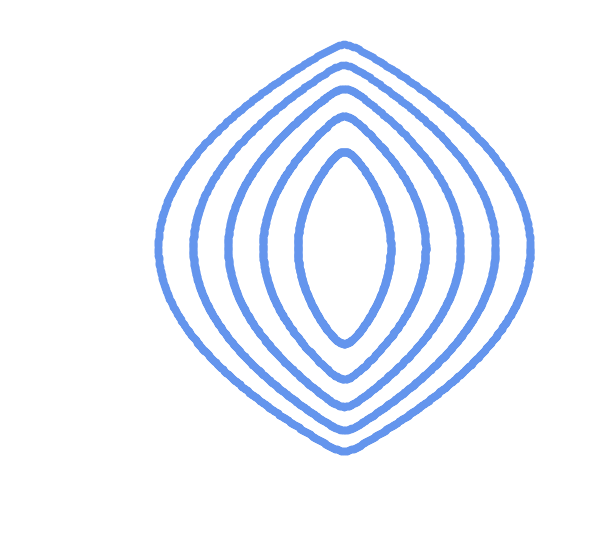

In [213]:
# Create a figure with dark background
fig, ax = plt.subplots(figsize=(6,6), facecolor='none')
ax.set_facecolor('none')

# Scatter plot with light colored points
ax.scatter(ps_iso[:,0], ps_iso[:,1], c='cornflowerblue', s=20)

# Style elements with white color
ax.set_xlabel('position', fontsize=30, color='white')
ax.set_ylabel('velocity', fontsize=30, color='white')
ax.set_xlim(-0.9, 0.9)
ax.set_ylim(-0.9, 0.9)
ax.set_xticks(np.arange(-1, 1.5, 0.5))
ax.set_yticks(np.arange(-1, 1.5, 0.5))
ax.tick_params(axis='both', labelsize=15, colors='white')

# Set spine colors to white
for spine in ax.spines.values():
    spine.set_linewidth(1)
    spine.set_color('white')
    # Make ticks larger and more visible against dark background
    ax.tick_params(axis='both', which='major', width=1.5, length=6, labelsize=15, colors='white')

fig.savefig("iso_orbit_no_background.png", dpi=300, bbox_inches='tight')

In [137]:
from galpy.actionAngle import actionAngleVertical

In [138]:
ps_iso.T[...,::10]

tensor([[ 0.2000,  0.1975,  0.1900,  0.1774,  0.1598,  0.1372,  0.1096,  0.0770,
          0.0397, -0.0012, -0.0419, -0.0790, -0.1113, -0.1387, -0.1610, -0.1783,
         -0.1905, -0.1978, -0.2000, -0.1972, -0.1894, -0.1765, -0.1587, -0.1358,
         -0.1079, -0.0750, -0.0374,  0.0036,  0.0442,  0.0810,  0.1130,  0.1401,
          0.1621,  0.1791,  0.1911,  0.1980,  0.2000,  0.1969,  0.1888,  0.1756,
          0.1575,  0.1343,  0.1061,  0.0730,  0.0351, -0.0060, -0.0464, -0.0830,
         -0.1147, -0.1415, -0.1632, -0.1799, -0.1916, -0.1983, -0.1999, -0.1966,
         -0.1882, -0.1747, -0.1563, -0.1328, -0.1044, -0.0709, -0.0329,  0.0083,
          0.0486,  0.0849,  0.1164,  0.1428,  0.1643,  0.1807,  0.1921,  0.1985,
          0.1999,  0.1962,  0.1875,  0.1738,  0.1551,  0.1313,  0.1026,  0.0689,
          0.0305, -0.0107, -0.0508, -0.0869, -0.1180, -0.1442, -0.1654, -0.1815,
         -0.1926, -0.1987, -0.1998, -0.1958, -0.1869, -0.1729, -0.1539, -0.1298,
         -0.1008, -0.0668, -

In [139]:
aAV = actionAngleVertical(pot=pot)
aAV._actionsFreqsAngles(*ps_iso.T[...,::100])

(array([0.03750385, 0.03750385, 0.03750385, 0.03750385, 0.03750385,
        0.03750385, 0.03750385, 0.03750385, 0.03750385, 0.03750385,
        0.08762783, 0.08762783, 0.08762783, 0.08762783, 0.08762783,
        0.08762783, 0.08762783, 0.08762783, 0.08762783, 0.08762783,
        0.14994731, 0.14994731, 0.14994731, 0.14994731, 0.14994731,
        0.14994731, 0.14994731, 0.14994732, 0.14994731, 0.14994731,
        0.22244214, 0.22244214, 0.22244214, 0.22244214, 0.22244214,
        0.22244214, 0.22244214, 0.22244214, 0.22244216, 0.22244214,
        0.30385002, 0.30385002, 0.30385002, 0.30385002, 0.30385002,
        0.30385002, 0.30385002, 0.30385002, 0.30385002, 0.30385003]),
 array([1.74915105, 1.74915102, 1.74915105, 1.74915105, 1.74915105,
        1.74915105, 1.74915105, 1.74915105, 1.74915102, 1.74915105,
        1.32728942, 1.32728942, 1.32728942, 1.32728942, 1.32728942,
        1.32728942, 1.3272894 , 1.32728942, 1.32728942, 1.32728942,
        1.11139372, 1.11139372, 1.11139372, 1.

In [203]:
j, omega, theta = aAV._actionsFreqsAngles(*ps_iso.T[...,::100])

In [204]:
j = j.reshape(5, 10).repeat(100, axis=-1)
theta = np.array([torch.linspace(0, 2*torch.pi, len(j[0]))]).repeat(len(j), axis=0)#theta.reshape(5, 10).repeat(100, axis=-1)

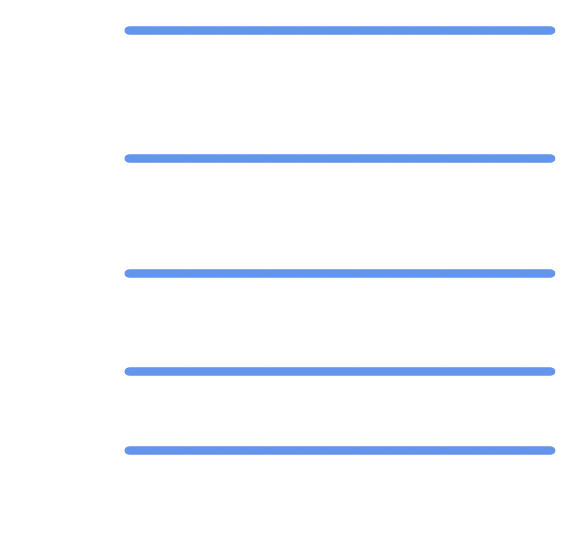

In [212]:
# Create a figure with dark background
fig, ax = plt.subplots(figsize=(6,6), facecolor='none')
ax.set_facecolor('none')

# Scatter plot with light colored points
ax.scatter(theta, j, color='cornflowerblue', s=20)

# Style elements with white color
ax.set_xlabel('angle', fontsize=30, color='white')
ax.set_ylabel('action', fontsize=30, color='white')
# ax.set_xlim(-0.9, 0.9)
# ax.set_ylim(-0.9, 0.9)
# ax.set_xticks(np.arange(-1, 1.5, 0.5))
# ax.set_yticks(np.arange(-1, 1.5, 0.5))
ax.tick_params(axis='both', labelsize=15, colors='white')

# Set spine colors to white
for spine in ax.spines.values():
    spine.set_linewidth(1)
    spine.set_color('white')
    # Make ticks larger and more visible against dark background
    ax.tick_params(axis='both', which='major', width=1.5, length=6, labelsize=15, colors='white')

fig.savefig("aa_orbit_no_background.png", dpi=300, bbox_inches='tight')

In [206]:
ps_sho = aAHI(torch.tensor(j), torch.tensor(theta))

In [207]:
ps_sho.shape

torch.Size([2, 5, 1000])

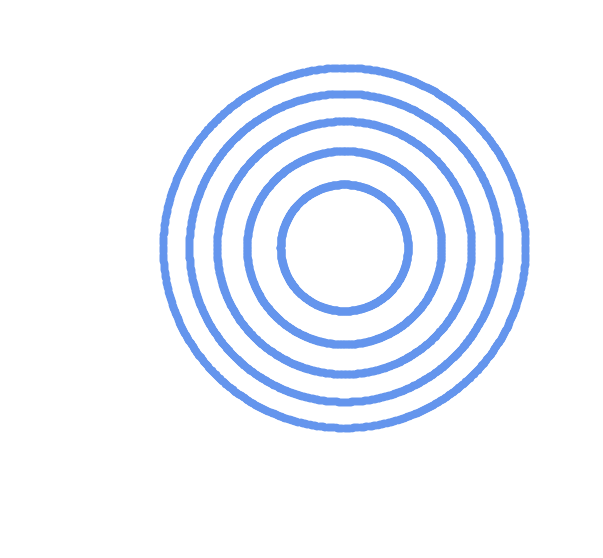

In [211]:
# Create a figure with dark background
fig, ax = plt.subplots(figsize=(6,6), facecolor='none')
ax.set_facecolor('none')

# Scatter plot with light colored points
ax.scatter(ps_sho[0], ps_sho[1], color='cornflowerblue', s=20)

# Style elements with white color
ax.set_xlabel('position', fontsize=30, color='white')
ax.set_ylabel('velocity', fontsize=30, color='white')
ax.set_xlim(-0.9, 0.9)
ax.set_ylim(-0.9, 0.9)
ax.set_xticks(np.arange(-1, 1.5, 0.5))
ax.set_yticks(np.arange(-1, 1.5, 0.5))
ax.tick_params(axis='both', labelsize=15, colors='white')

# Set spine colors to white
for spine in ax.spines.values():
    spine.set_linewidth(1)
    spine.set_color('white')
    # Make ticks larger and more visible against dark background
    ax.tick_params(axis='both', which='major', width=1.5, length=6, labelsize=15, colors='white')

fig.savefig("sho_orbit_no_background.png", dpi=300, bbox_inches='tight')

In [41]:
from nflows import generate_orbits_aa

In [44]:
# Orbit in action-angle
n_actions = 5
n_angles = 1000
j_min = 0.5
j_max = 1.5
aa = generate_orbits_aa(n_actions, n_angles, j_min, j_max)


In [61]:
aa[...,0]

tensor([[0.5000, 0.5000, 0.5000,  ..., 0.5000, 0.5000, 0.5000],
        [0.7500, 0.7500, 0.7500,  ..., 0.7500, 0.7500, 0.7500],
        [1.0000, 1.0000, 1.0000,  ..., 1.0000, 1.0000, 1.0000],
        [1.2500, 1.2500, 1.2500,  ..., 1.2500, 1.2500, 1.2500],
        [1.5000, 1.5000, 1.5000,  ..., 1.5000, 1.5000, 1.5000]])

In [62]:
aa.T

tensor([[[0.5000, 0.7500, 1.0000, 1.2500, 1.5000],
         [0.5000, 0.7500, 1.0000, 1.2500, 1.5000],
         [0.5000, 0.7500, 1.0000, 1.2500, 1.5000],
         ...,
         [0.5000, 0.7500, 1.0000, 1.2500, 1.5000],
         [0.5000, 0.7500, 1.0000, 1.2500, 1.5000],
         [0.5000, 0.7500, 1.0000, 1.2500, 1.5000]],

        [[0.0063, 0.0063, 0.0063, 0.0063, 0.0063],
         [0.0126, 0.0126, 0.0126, 0.0126, 0.0126],
         [0.0188, 0.0188, 0.0188, 0.0188, 0.0188],
         ...,
         [6.2644, 6.2644, 6.2644, 6.2644, 6.2644],
         [6.2706, 6.2706, 6.2706, 6.2706, 6.2706],
         [6.2769, 6.2769, 6.2769, 6.2769, 6.2769]]])

In [ ]:
ps_sho = aAHI(*aa.T)
# Reshape aa to separate actions and angles for proper broadcasting
actions = aa[..., 0].flatten()
angles = aa[..., 1].flatten()
# Call _xvFreqs with proper input format - it expects separate inputs for action and angle
ps_iso = torch.tensor(np.array([aAVI._xvFreqs(j, a) for j, a in zip(actions.numpy(), angles.numpy())]))

ValueError: Given action/energy not found, to use interpolation, initialize with setup_interp=True

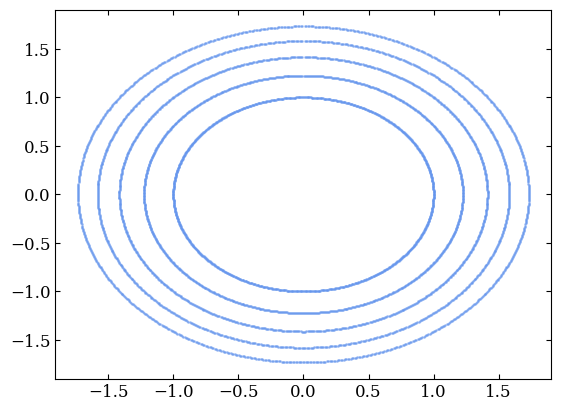

In [56]:
plt.scatter(*ps_sho, s=1, c='cornflowerblue', alpha=0.5)

In [37]:
aAH(0.5, 0.5)

0.25

In [ ]:
aAV()